In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
sns.color_palette("bright")


[(0.00784313725490196, 0.24313725490196078, 1.0),
 (1.0, 0.48627450980392156, 0.0),
 (0.10196078431372549, 0.788235294117647, 0.2196078431372549),
 (0.9098039215686274, 0.0, 0.043137254901960784),
 (0.5450980392156862, 0.16862745098039217, 0.8862745098039215),
 (0.6235294117647059, 0.2823529411764706, 0.0),
 (0.9450980392156862, 0.2980392156862745, 0.7568627450980392),
 (0.6392156862745098, 0.6392156862745098, 0.6392156862745098),
 (1.0, 0.7686274509803922, 0.0),
 (0.0, 0.8431372549019608, 1.0)]

In [2]:
X = np.load('data/processed_extrapolation.npy', allow_pickle=True)


In [3]:
print(X[()]['data'].shape)
print(X[()]['Nmax'].shape)



(19, 10)
(9,)


In [4]:
# We have to figure out a network now, the idea is to get an ODE to integrate this.

In [5]:
import math
import numpy as np
from IPython.display import clear_output
from tqdm import tqdm_notebook as tqdm

import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
sns.color_palette("bright")
import matplotlib as mpl
import matplotlib.cm as cm

import torch
from torch import Tensor
from torch import nn
from torch.nn  import functional as F 
from torch.autograd import Variable

use_cuda = torch.cuda.is_available()


def ode_solve(z0, t0, t1, f):
    """
    Simplest Euler ODE initial value solver
    """
    h_max = 0.05
    n_steps = math.ceil((abs(t1 - t0)/h_max).max().item())

    h = (t1 - t0)/n_steps
    t = t0
    z = z0

    for i_step in range(n_steps):
        z = z + h * f(z, t)
        t = t + h
    return z



## Let us now figure out how to get a model.
class ODEF(nn.Module):
    def forward_with_grad(self, z, t, grad_outputs):
        """Compute f and a df/dz, a df/dp, a df/dt"""
        batch_size = z.shape[0]

        out = self.forward(z, t)

        a = grad_outputs
        adfdz, adfdt, *adfdp = torch.autograd.grad(
            (out,), (z, t) + tuple(self.parameters()), grad_outputs=(a),
            allow_unused=True, retain_graph=True
        )
        # grad method automatically sums gradients for batch items, we have to expand them back
        if adfdp is not None:
            adfdp = torch.cat([p_grad.flatten()
                              for p_grad in adfdp]).unsqueeze(0)
            adfdp = adfdp.expand(batch_size, -1) / batch_size
        if adfdt is not None:
            adfdt = adfdt.expand(batch_size, 1) / batch_size
        return out, adfdz, adfdt, adfdp

    def flatten_parameters(self):
        p_shapes = []
        flat_parameters = []
        for p in self.parameters():
            p_shapes.append(p.size())
            flat_parameters.append(p.flatten())
        return torch.cat(flat_parameters)

In [6]:
class ODEAdjoint(torch.autograd.Function):
    @staticmethod
    def forward(ctx, z0, t, flat_parameters, func):
        assert isinstance(func, ODEF)
        bs, *z_shape = z0.size()
        time_len = t.size(0)

        with torch.no_grad():
            z = torch.zeros(time_len, bs, *z_shape).to(z0)
            z[0] = z0
            for i_t in range(time_len - 1):
                z0 = ode_solve(z0, t[i_t], t[i_t+1], func)
                z[i_t+1] = z0

        ctx.func = func
        ctx.save_for_backward(t, z.clone(), flat_parameters)
        return z

    @staticmethod
    def backward(ctx, dLdz):
        """
        dLdz shape: time_len, batch_size, *z_shape
        """
        func = ctx.func
        t, z, flat_parameters = ctx.saved_tensors
        time_len, bs, *z_shape = z.size()
        n_dim = np.prod(z_shape)
        n_params = flat_parameters.size(0)

        # Dynamics of augmented system to be calculated backwards in time
        def augmented_dynamics(aug_z_i, t_i):
            """
            tensors here are temporal slices
            t_i - is tensor with size: bs, 1
            aug_z_i - is tensor with size: bs, n_dim*2 + n_params + 1
            """
            z_i, a = aug_z_i[:, :n_dim], aug_z_i[:, n_dim:2*n_dim]  # ignore parameters and time

            # Unflatten z and a
            z_i = z_i.view(bs, *z_shape)
            a = a.view(bs, *z_shape)
            with torch.set_grad_enabled(True):
                t_i = t_i.detach().requires_grad_(True)
                z_i = z_i.detach().requires_grad_(True)
                func_eval, adfdz, adfdt, adfdp = func.forward_with_grad(z_i, t_i, grad_outputs=a)  # bs, *z_shape
                adfdz = adfdz.to(z_i) if adfdz is not None else torch.zeros(bs, *z_shape).to(z_i)
                adfdp = adfdp.to(z_i) if adfdp is not None else torch.zeros(bs, n_params).to(z_i)
                adfdt = adfdt.to(z_i) if adfdt is not None else torch.zeros(bs, 1).to(z_i)

            # Flatten f and adfdz
            func_eval = func_eval.view(bs, n_dim)
            adfdz = adfdz.view(bs, n_dim) 
            return torch.cat((func_eval, -adfdz, -adfdp, -adfdt), dim=1)

        dLdz = dLdz.view(time_len, bs, n_dim)  # flatten dLdz for convenience
        with torch.no_grad():
            ## Create placeholders for output gradients
            # Prev computed backwards adjoints to be adjusted by direct gradients
            adj_z = torch.zeros(bs, n_dim).to(dLdz)
            adj_p = torch.zeros(bs, n_params).to(dLdz)
            # In contrast to z and p we need to return gradients for all times
            adj_t = torch.zeros(time_len, bs, 1).to(dLdz)

            for i_t in range(time_len-1, 0, -1):
                z_i = z[i_t]
                t_i = t[i_t]
                f_i = func(z_i, t_i).view(bs, n_dim)

                # Compute direct gradients
                dLdz_i = dLdz[i_t]
                dLdt_i = torch.bmm(torch.transpose(dLdz_i.unsqueeze(-1), 1, 2), f_i.unsqueeze(-1))[:, 0]

                # Adjusting adjoints with direct gradients
                adj_z += dLdz_i
                adj_t[i_t] = adj_t[i_t] - dLdt_i

                # Pack augmented variable
                aug_z = torch.cat((z_i.view(bs, n_dim), adj_z, torch.zeros(bs, n_params).to(z), adj_t[i_t]), dim=-1)

                # Solve augmented system backwards
                aug_ans = ode_solve(aug_z, t_i, t[i_t-1], augmented_dynamics)

                # Unpack solved backwards augmented system
                adj_z[:] = aug_ans[:, n_dim:2*n_dim]
                adj_p[:] += aug_ans[:, 2*n_dim:2*n_dim + n_params]
                adj_t[i_t-1] = aug_ans[:, 2*n_dim + n_params:]

                del aug_z, aug_ans

            ## Adjust 0 time adjoint with direct gradients
            # Compute direct gradients 
            dLdz_0 = dLdz[0]
            dLdt_0 = torch.bmm(torch.transpose(dLdz_0.unsqueeze(-1), 1, 2), f_i.unsqueeze(-1))[:, 0]

            # Adjust adjoints
            adj_z += dLdz_0
            adj_t[0] = adj_t[0] - dLdt_0
        return adj_z.view(bs, *z_shape), adj_t, adj_p, None

In [7]:
class NeuralODE(nn.Module):
    def __init__(self, func):
        super(NeuralODE, self).__init__()
        assert isinstance(func, ODEF)
        self.func = func

    def forward(self, z0, t=Tensor([0., 1.]), return_whole_sequence=False):
        t = t.to(z0)
        # print("the data", t, t.size(), z0.size())
        z = ODEAdjoint.apply(z0, t, self.func.flatten_parameters(), self.func)
        if return_whole_sequence:
            return z
        else:
            return z[-1]

In [8]:
class NNODEF(ODEF):
    def __init__(self, in_dim, hid_dim, time_invariant=False):
        super(NNODEF, self).__init__()
        self.time_invariant = time_invariant
        
        if time_invariant:
            self.lin1 = nn.Linear(in_dim, hid_dim)
        else:
            self.lin1 = nn.Linear(in_dim+1, hid_dim)
        self.lin2     = nn.Linear(hid_dim, hid_dim)
        self.lin3     = nn.Linear(hid_dim, in_dim)
        self.elu      = nn.ELU(inplace=True)

    def forward(self, x, t):
        # print(x.shape, t.shape)
        if not self.time_invariant:
            x = torch.cat((x, t.reshape([1,-1]) ), dim=-1)
        # print(x.shape)
        h = self.elu(self.lin1(x))
        h = self.elu(self.lin2(h))
        out = self.lin3(h)
        return out
    
def to_np(x):
    return x.detach().cpu().numpy()


In [9]:
class RNNEncoder(nn.Module):
    def __init__(self, input_dim, hidden_dim, latent_dim):
        super(RNNEncoder, self).__init__()
        self.input_dim = input_dim
        self.hidden_dim = hidden_dim
        self.latent_dim = latent_dim

        self.rnn = nn.GRU(input_dim+1, hidden_dim)
        self.hid2lat = nn.Linear(hidden_dim, 2*latent_dim)

    def forward(self, x, t):
        # Concatenate time to input
        t = t.clone()
        t[1:] = t[:-1] - t[1:]
        t[0] = 0.
        xt = torch.cat((x, t), dim=-1)

        _, h0 = self.rnn(xt.flip((0,)))  # Reversed
        # Compute latent dimension
        z0 = self.hid2lat(h0[0])
        z0_mean = z0[:, :self.latent_dim]
        z0_log_var = z0[:, self.latent_dim:]
        return z0_mean, z0_log_var


In [10]:
class NeuralODEDecoder(nn.Module):
    def __init__(self, output_dim, hidden_dim, latent_dim):
        super(NeuralODEDecoder, self).__init__()
        self.output_dim = output_dim
        self.hidden_dim = hidden_dim
        self.latent_dim = latent_dim

        func = NNODEF(latent_dim, hidden_dim, time_invariant=True)
        self.ode = NeuralODE(func)
        self.l2h = nn.Linear(latent_dim, hidden_dim)
        self.h2o = nn.Linear(hidden_dim, output_dim)

    def forward(self, z0, t):
        zs = self.ode(z0, t, return_whole_sequence=True)

        hs = self.l2h(zs)
        xs = self.h2o(hs)
        return xs


In [11]:
class ODEVAE(nn.Module):
    def __init__(self, output_dim, hidden_dim, latent_dim):
        super(ODEVAE, self).__init__()
        self.output_dim = output_dim
        self.hidden_dim = hidden_dim
        self.latent_dim = latent_dim

        self.encoder = RNNEncoder(output_dim, hidden_dim, latent_dim)
        self.decoder = NeuralODEDecoder(output_dim, hidden_dim, latent_dim)

    def forward(self, x, t, MAP=False):
        z_mean, z_log_var = self.encoder(x, t)
        if MAP:
            z = z_mean
        else:
            z = z_mean + torch.randn_like(z_mean) * torch.exp(0.5 * z_log_var)
        x_p = self.decoder(z, t)
        return x_p, z, z_mean, z_log_var

    def generate_with_seed(self, seed_x, t):
        seed_t_len = seed_x.shape[0]
        z_mean, z_log_var = self.encoder(seed_x, t[:seed_t_len])
        x_p = self.decoder(z_mean, t)
        return x_p


In [12]:
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import seaborn as sns


small = 16
med = 18
large = 20


def to_np(x):
    return x.detach().numpy()

def conduct_experiment_latent(X, ode_trained, n_steps):

    z0 = Variable(torch.Tensor([[0.6, 0.3]]))

    E = X[()]['data'][:, 1:]
    h_omega = X[()]['data'][:, 0]/50
    N_Max = X[()]['Nmax'].reshape([-1])/18
    n_points = h_omega.shape[0]
    noise_std = 1
    permutation = [np.random.randint(0, n_points) for k in range(10)]
    ETr = E[permutation]
    h_omegaT = h_omega[permutation]

    def create_batch_latent(X, y):
        idx = [ np.random.randint(0, X.shape[0]) for _ in range(20) ]

        obs_=torch.from_numpy( X[idx, :].astype(np.float32).T).unsqueeze(2)

        ts_ = np.vstack(N_Max).astype(np.float32).reshape([-1, 1])
        ts_ = torch.from_numpy(np.repeat(ts_, obs_.shape[1], axis=1)).unsqueeze(2)


        ho_ = torch.from_numpy( np.repeat( y[idx].astype(
            np.float32).reshape([1,-1]), obs_.shape[0], axis = 0)).unsqueeze(2)
        
        # print(ho_.dtype, obs_.dtype, ts_.dtype)
        # print(ho_.shape, obs_.shape, ts_.shape)

        
        return obs_, ts_, ho_


    def create_batch_latent_order(X, y):
        idx = [ i for i in range(X.shape[0]) ]

        obs_=torch.from_numpy( X[idx, :].astype(np.float32).T).unsqueeze(2)

        ts_ = np.vstack(N_Max).astype(np.float32).reshape([-1, 1])
        ts_ = torch.from_numpy(np.repeat(ts_, obs_.shape[1], axis=1)).unsqueeze(2)


        ho_ = torch.from_numpy( np.repeat( y[idx].astype(
            np.float32).reshape([1,-1]), obs_.shape[0], axis = 0)).unsqueeze(2)
        
        # print(ho_.dtype, obs_.dtype, ts_.dtype)
        # print(ho_.shape, obs_.shape, ts_.shape)

        
        return obs_, ts_, ho_

    # Train Neural ODE
    optimizer = torch.optim.Adam(ode_trained.parameters(), lr=1e-3)
    for i in range(n_steps):
        obs_, ts_, ho_ = create_batch_latent(ETr, h_omegaT)
        input_d = torch.cat( [obs_, ho_], axis=2)
        # print(input_d, input_d.shape, ts_)
        # z_ = ode_trained(input_d, ts_, return_whole_sequence=True).squeeze(1)
        x_p, z, z_mean, z_log_var = ode_trained(input_d, ts_)
        # input_d = torch.cat(
        #     [obs_.reshape([-1, 1]), torch.tensor(np.tile(ho_, 9)).reshape([-1, 1])], axis=1)
        kl_loss = -0.5 * torch.sum(1 + z_log_var - z_mean**2 - torch.exp(z_log_var), -1)
        error_loss = 0.5 * ((input_d-x_p)**2).sum(-1).sum(0) / noise_std**2
        loss = torch.mean(error_loss+ kl_loss)

        
        
        optimizer.zero_grad()
        loss.backward(retain_graph=True)
        optimizer.step()
    
        if i %1000 == 0:
            obs_, ts_, ho_ = create_batch_latent_order(E, h_omega)
            input_d = torch.cat([obs_, ho_], axis=2)

            samp_trajs_p = to_np(ode_trained.generate_with_seed(input_d, ts_))
            print(samp_trajs_p.shape)

            plt.figure()
            
            fig, axes = plt.subplots(nrows=3, ncols=6, facecolor='white', figsize=(9, 9),  gridspec_kw={'wspace': 0.5, 'hspace': 0.5}, dpi=400)
            axes = axes.flatten()
            for j, ax in enumerate(axes):
                
                ax.plot(18*ts_[:, j, 0], input_d[:, j, 0], label='real', linewidth = 1)
                ax.scatter(18*ts_[:, j, 0], samp_trajs_p[:, j, 0], 3,
                           label="predicted" , marker='*',
                           c=samp_trajs_p[:, j, 0], cmap=cm.plasma)
                ax.grid("True")
                ax.set_xlabel('NMax, \n h$\\Omega$ = '+str( np.round(ho_[0,j,0].item()*50, 2 )), fontsize = 10)

                if j == 5:
                    ax.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
                if j == 0 or j==6 or j ==12:
                    ax.set_ylabel('Ground state Energy', fontsize = 10)
            
            print("Step:", i, "Total_Loss:"+str(loss.item()) + " with error",\
            str(torch.mean(error_loss).item())+" KL divergence"+ str(torch.mean(kl_loss).item()) )
            plt.text(20, 75, "\n Total loss: "+str(np.round(loss.item(), 2)) + "\n with error: " + str(np.round(torch.mean(error_loss).item(), 2))+" \n KL divergence: " + str(np.round(torch.mean(kl_loss).item(), 2)))
            plt.savefig('Figures/reconstruction_'+str(i)+'.png', dpi= 300,  bbox_inches="tight")
            plt.show()




(9, 19, 2)
Step: 0 Total_Loss:3512.754638671875 with error 3512.353515625 KL divergence0.4012581706047058


<Figure size 432x288 with 0 Axes>

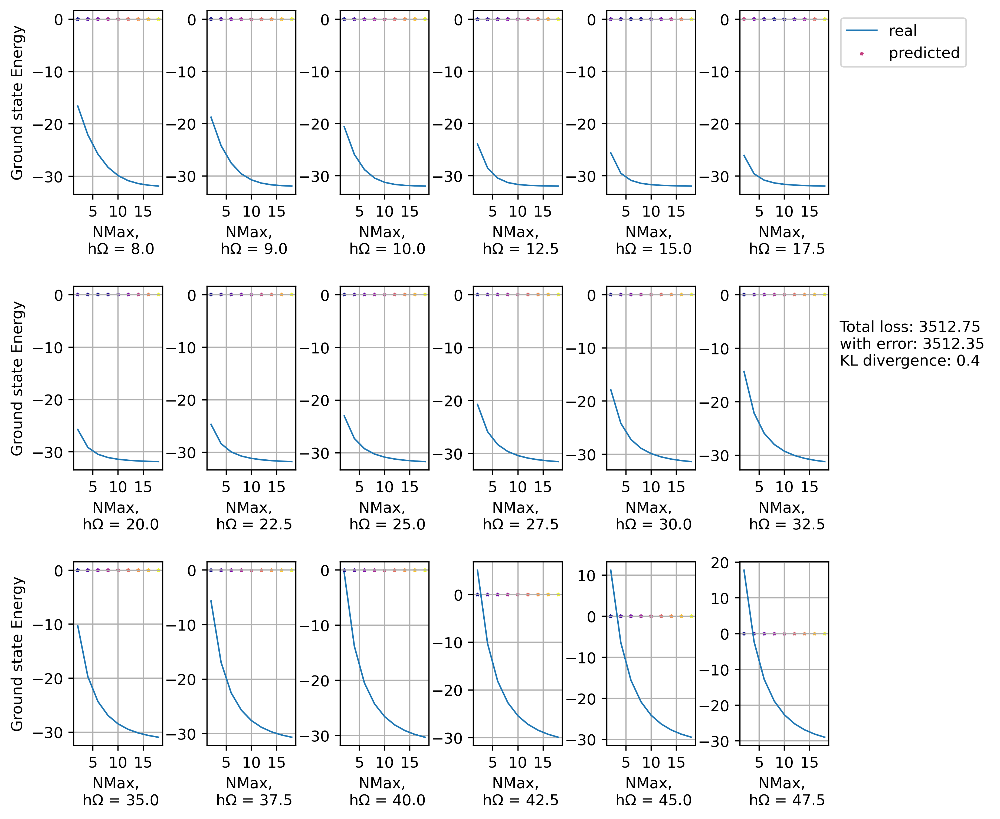

(9, 19, 2)
Step: 1000 Total_Loss:17.84719467163086 with error 5.411508560180664 KL divergence12.435686111450195


<Figure size 432x288 with 0 Axes>

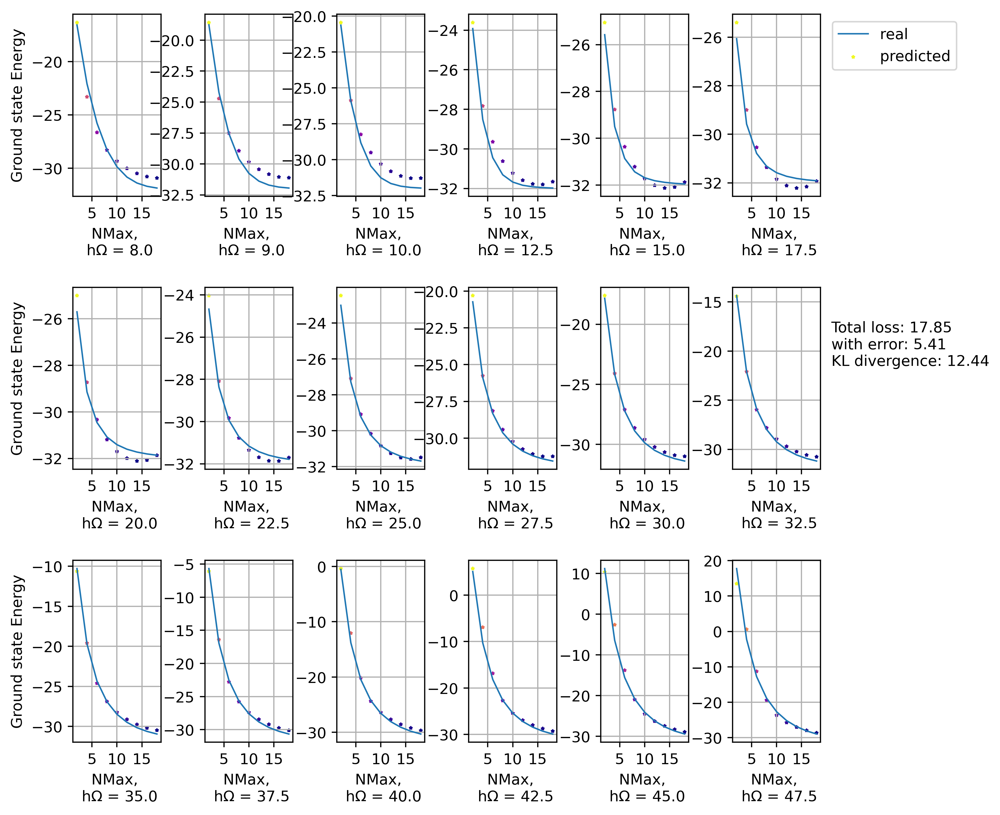

(9, 19, 2)
Step: 2000 Total_Loss:12.760846138000488 with error 4.045754432678223 KL divergence8.715089797973633


<Figure size 432x288 with 0 Axes>

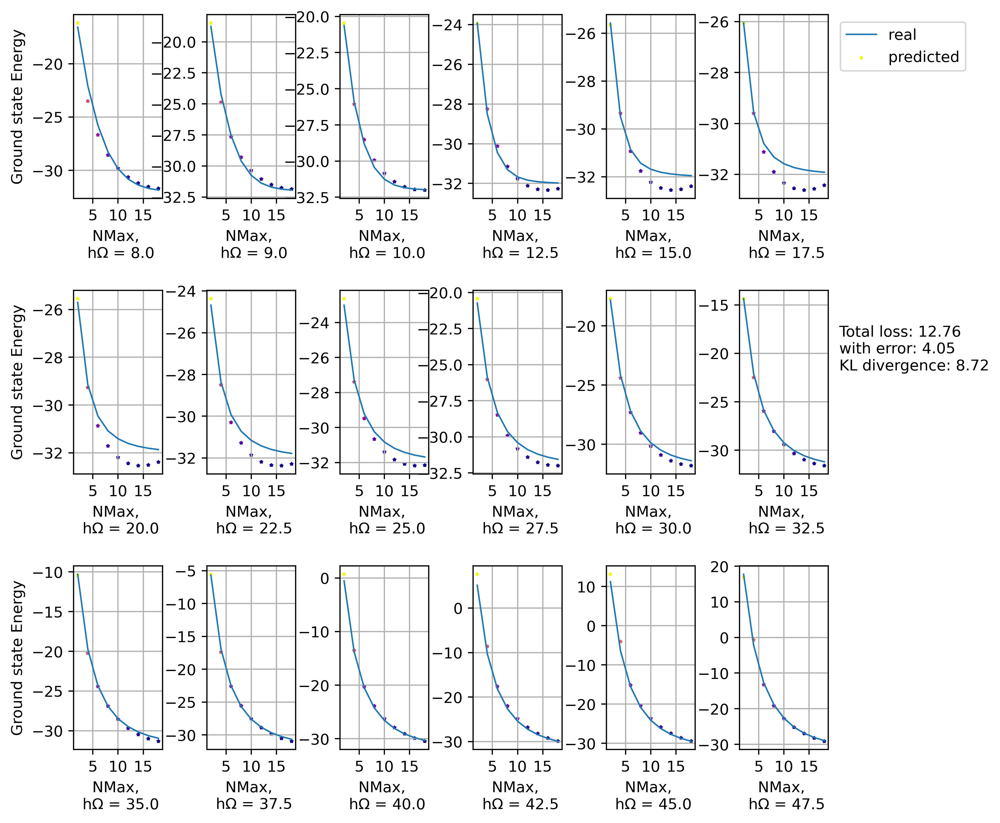

(9, 19, 2)
Step: 3000 Total_Loss:9.88294792175293 with error 2.1185808181762695 KL divergence7.764366149902344


<Figure size 432x288 with 0 Axes>

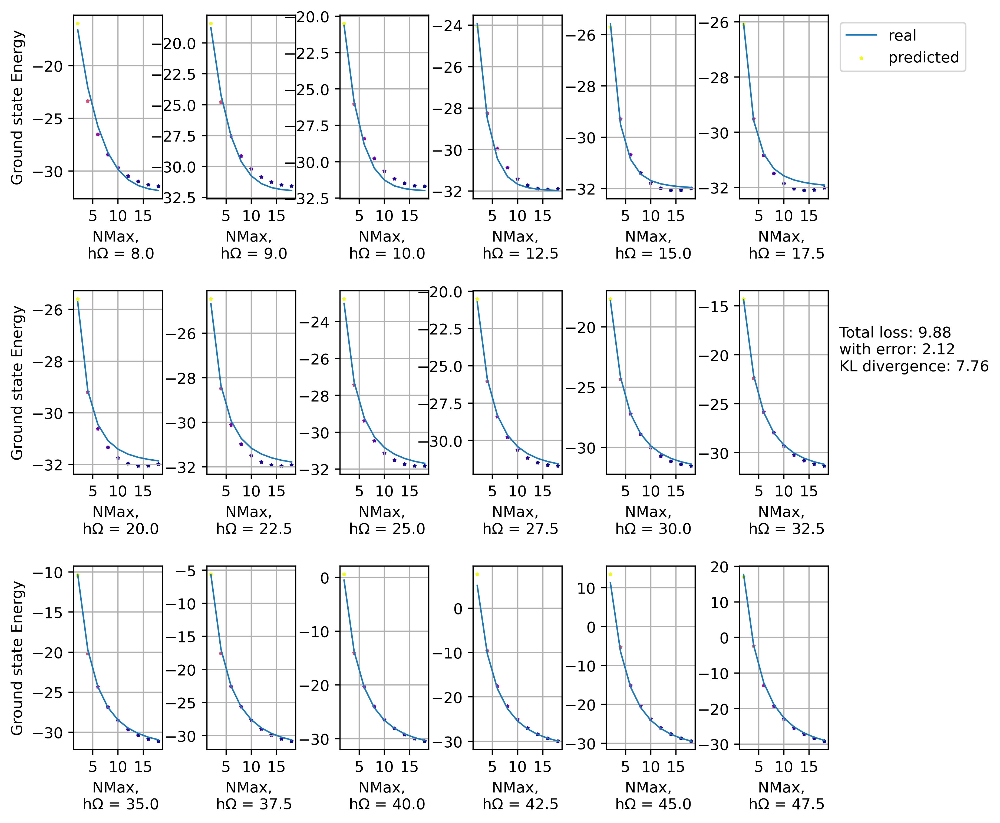

(9, 19, 2)
Step: 4000 Total_Loss:10.7803955078125 with error 3.9585299491882324 KL divergence6.821866035461426


<Figure size 432x288 with 0 Axes>

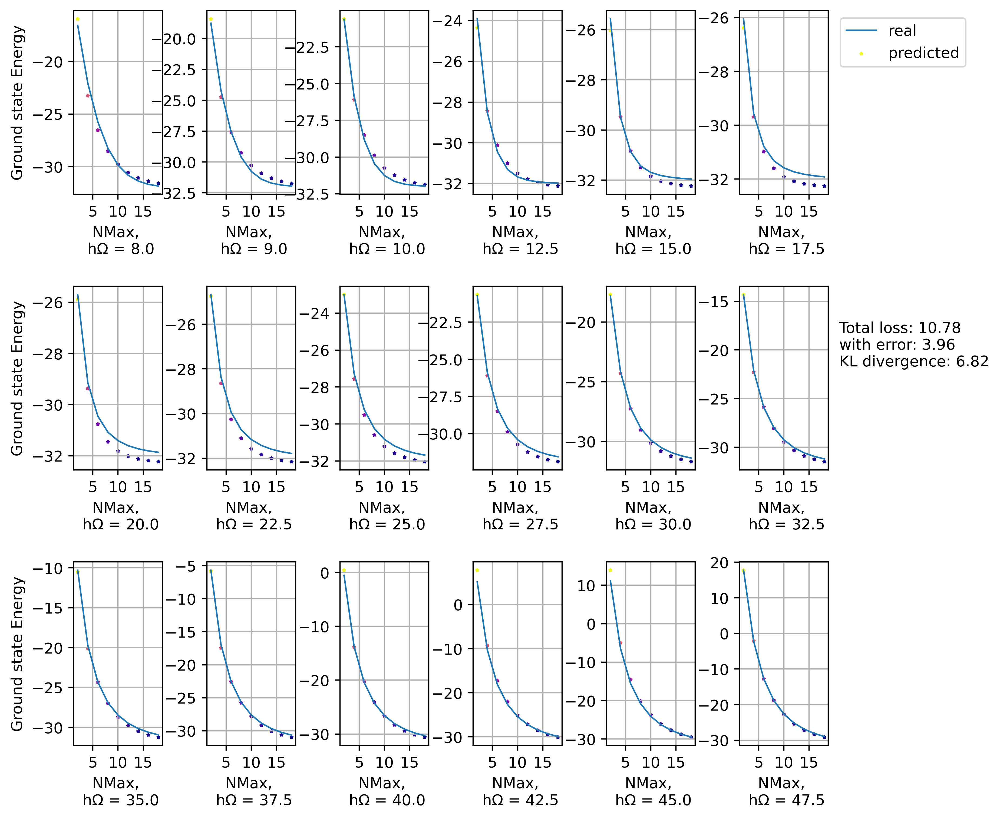

(9, 19, 2)
Step: 5000 Total_Loss:11.158239364624023 with error 3.9183402061462402 KL divergence7.2399001121521


<Figure size 432x288 with 0 Axes>

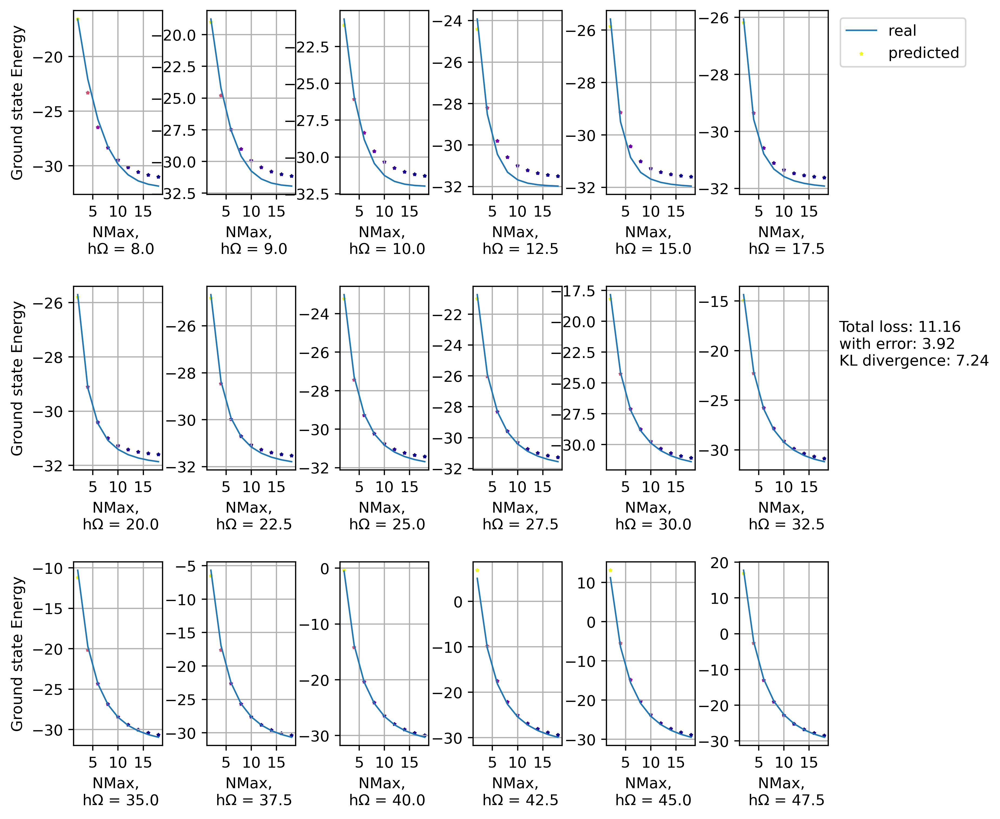

(9, 19, 2)
Step: 6000 Total_Loss:7.217443943023682 with error 2.0161516666412354 KL divergence5.201291561126709


<Figure size 432x288 with 0 Axes>

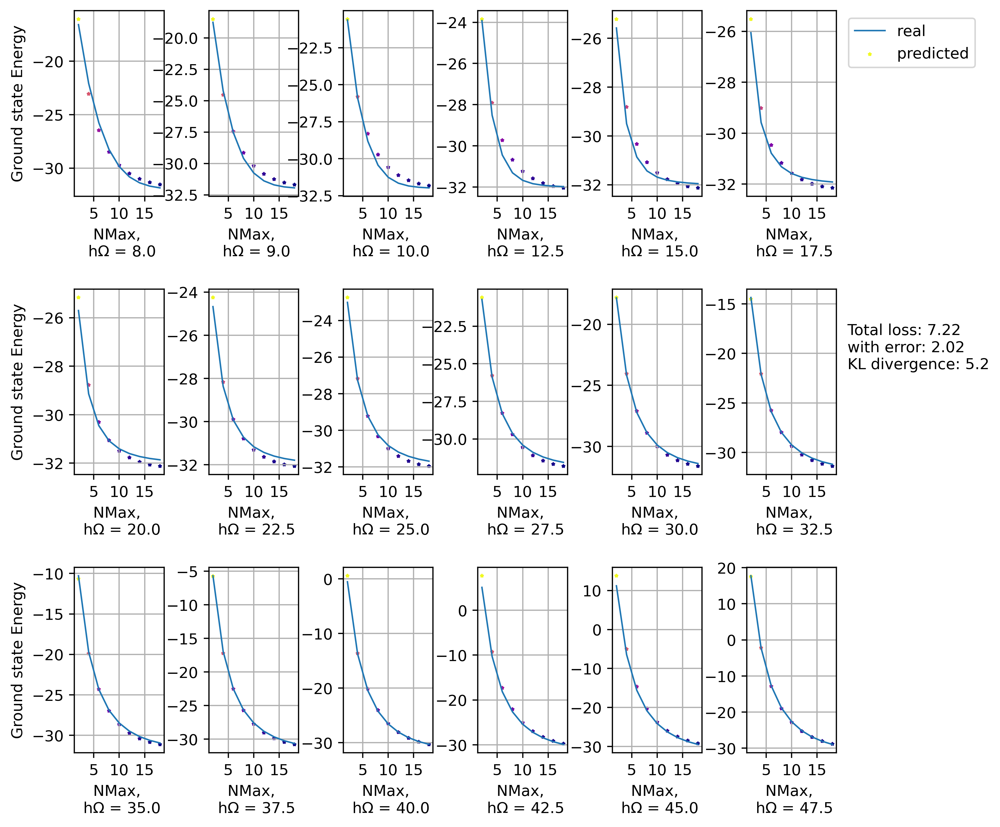

(9, 19, 2)
Step: 7000 Total_Loss:6.2770094871521 with error 1.3778423070907593 KL divergence4.899167537689209


<Figure size 432x288 with 0 Axes>

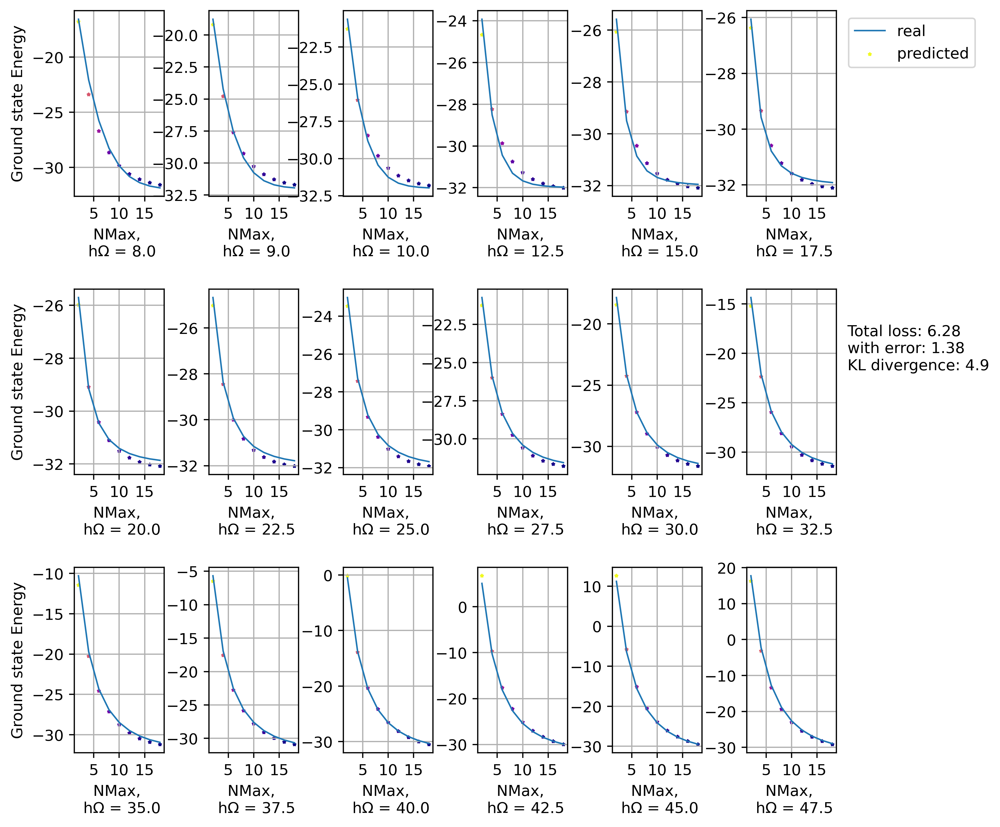

(9, 19, 2)
Step: 8000 Total_Loss:4.843486785888672 with error 1.6839641332626343 KL divergence3.1595230102539062


<Figure size 432x288 with 0 Axes>

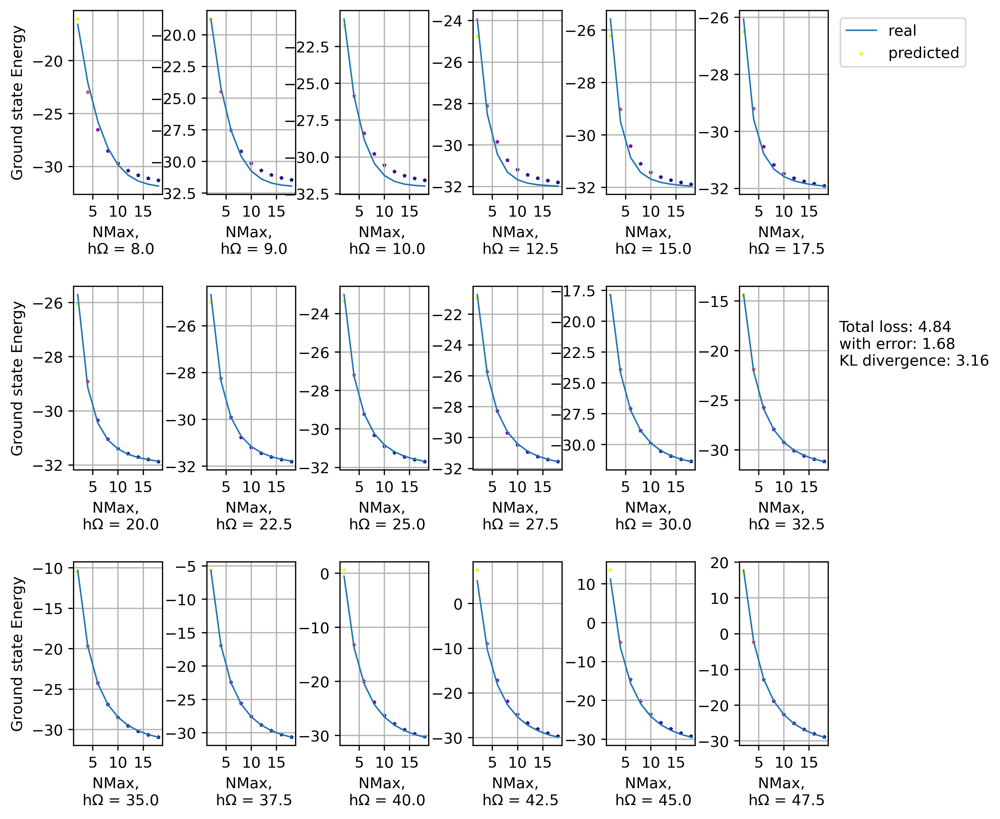

(9, 19, 2)
Step: 9000 Total_Loss:3.889521837234497 with error 1.064911961555481 KL divergence2.8246097564697266


<Figure size 432x288 with 0 Axes>

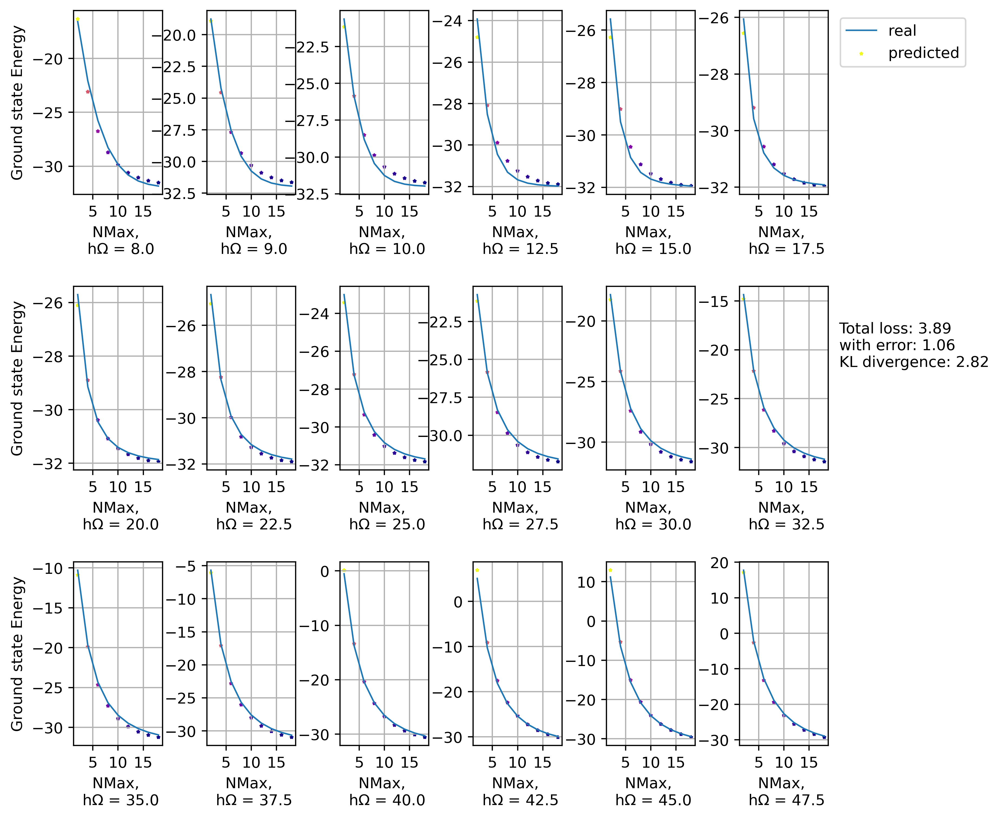

(9, 19, 2)
Step: 10000 Total_Loss:3.962794065475464 with error 1.180044174194336 KL divergence2.782749891281128


<Figure size 432x288 with 0 Axes>

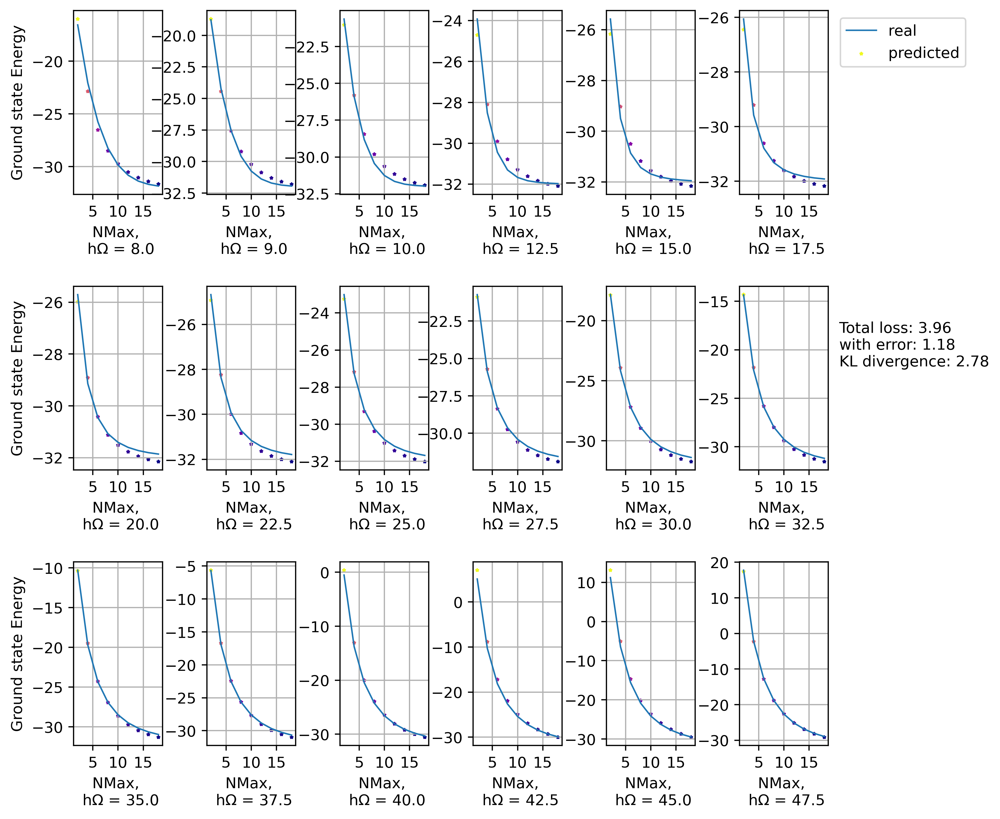

(9, 19, 2)
Step: 11000 Total_Loss:4.2317681312561035 with error 1.1770633459091187 KL divergence3.054704189300537


<Figure size 432x288 with 0 Axes>

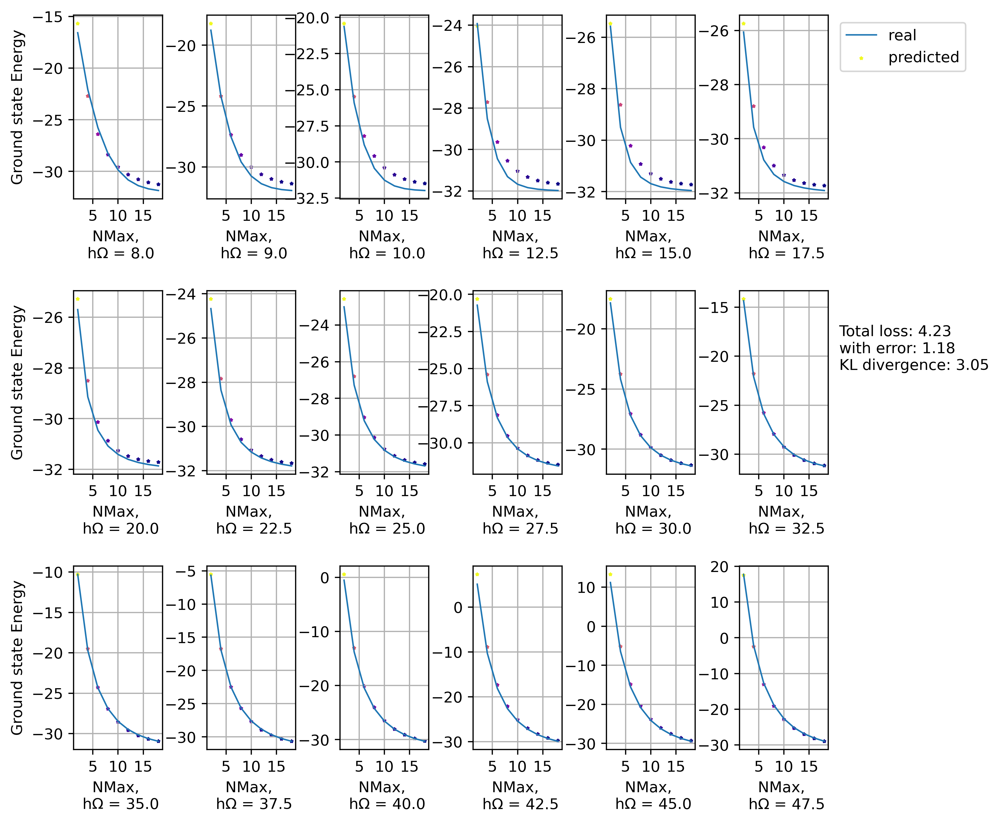

(9, 19, 2)
Step: 12000 Total_Loss:3.8140628337860107 with error 1.3225630521774292 KL divergence2.491499185562134


<Figure size 432x288 with 0 Axes>

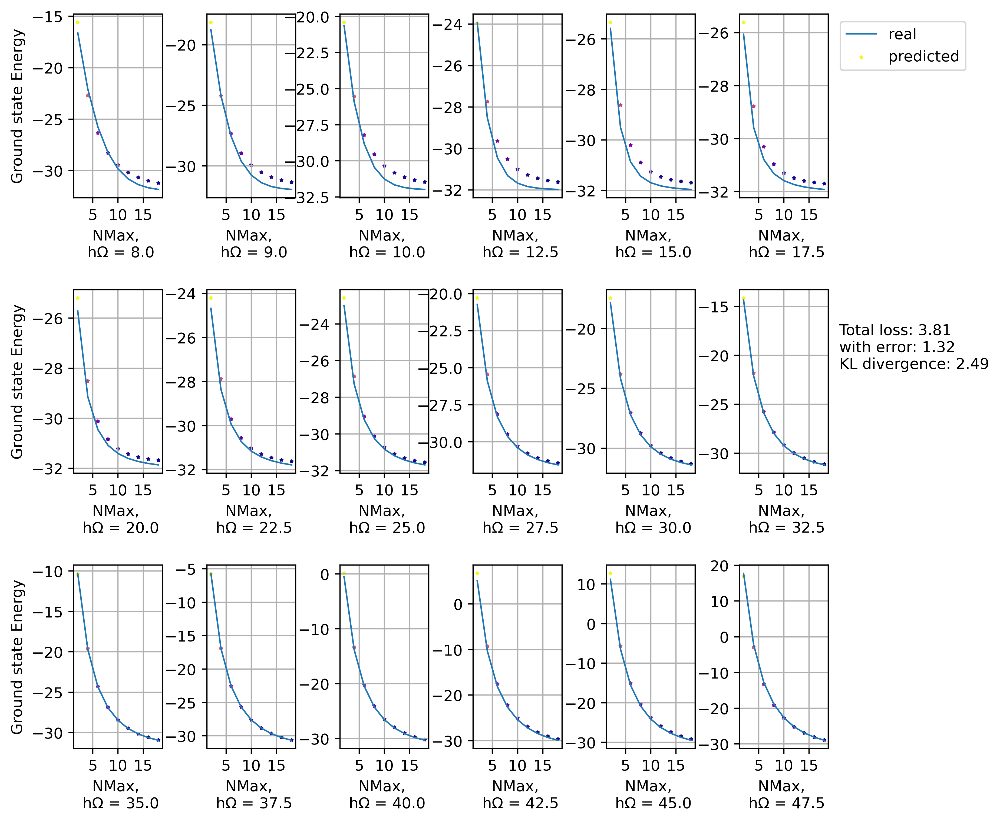

(9, 19, 2)
Step: 13000 Total_Loss:2.7879250049591064 with error 0.5987340807914734 KL divergence2.1891911029815674


<Figure size 432x288 with 0 Axes>

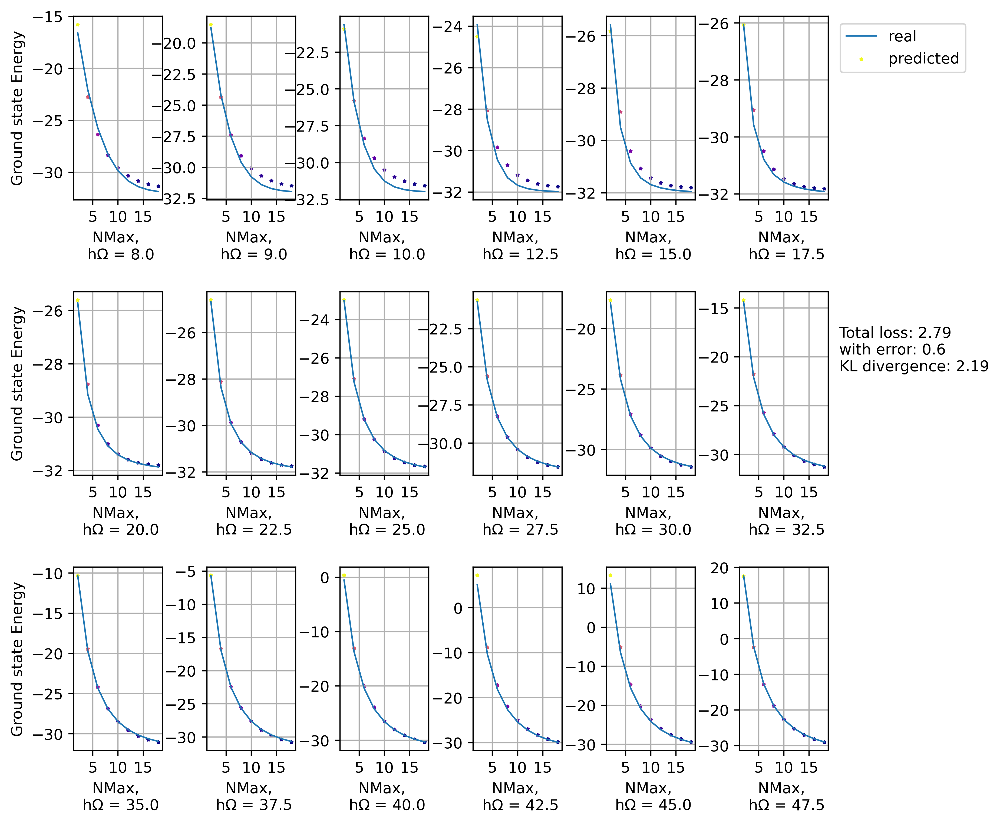

(9, 19, 2)
Step: 14000 Total_Loss:4.055001735687256 with error 1.0332794189453125 KL divergence3.0217225551605225


<Figure size 432x288 with 0 Axes>

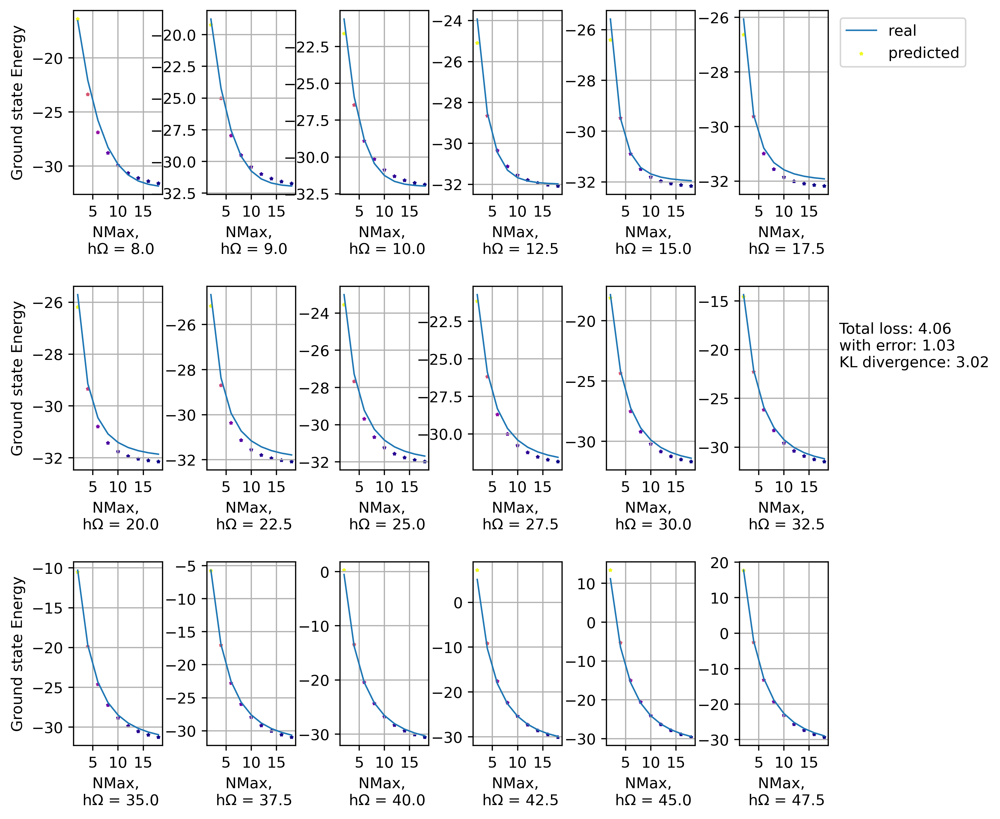

(9, 19, 2)
Step: 15000 Total_Loss:4.149404525756836 with error 1.2167366743087769 KL divergence2.9326674938201904


<Figure size 432x288 with 0 Axes>

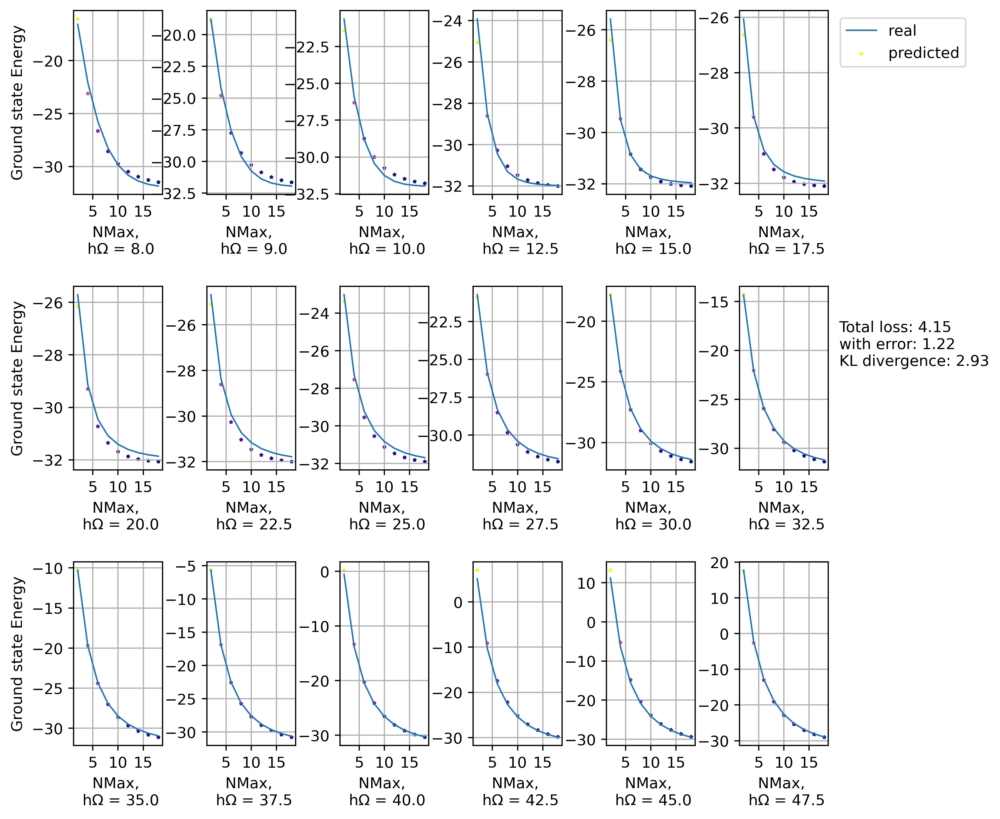

(9, 19, 2)
Step: 16000 Total_Loss:3.6582541465759277 with error 1.0027955770492554 KL divergence2.655458927154541


<Figure size 432x288 with 0 Axes>

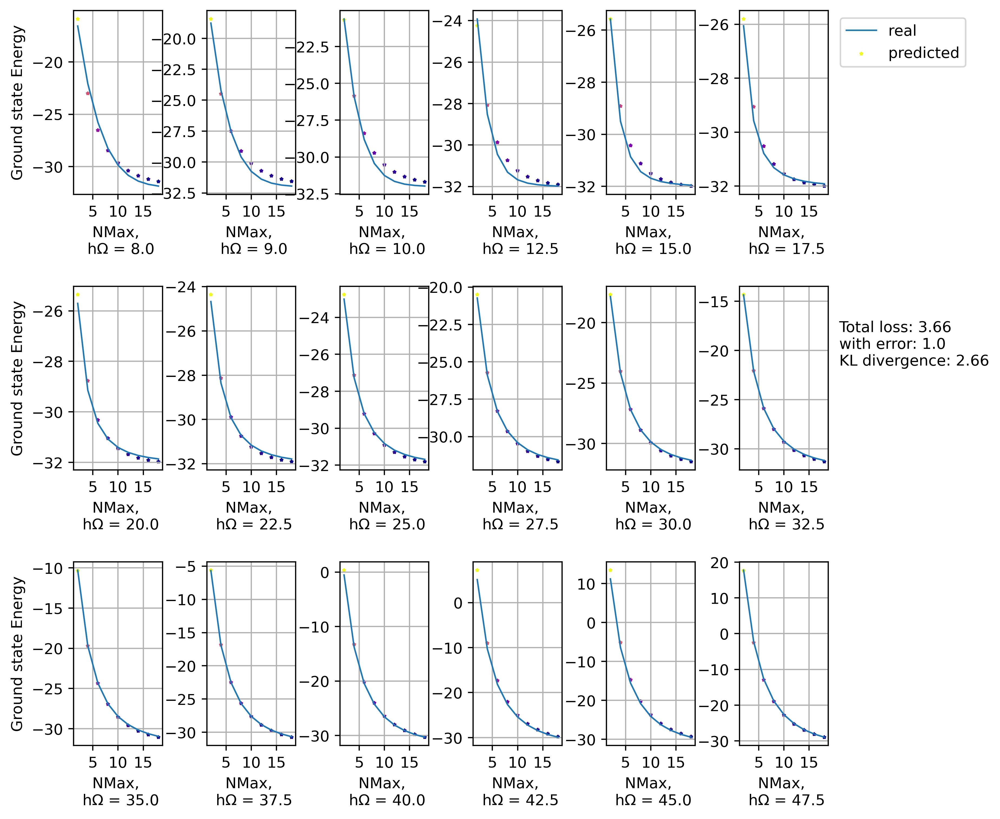

(9, 19, 2)
Step: 17000 Total_Loss:3.4787871837615967 with error 0.9543107748031616 KL divergence2.5244762897491455


<Figure size 432x288 with 0 Axes>

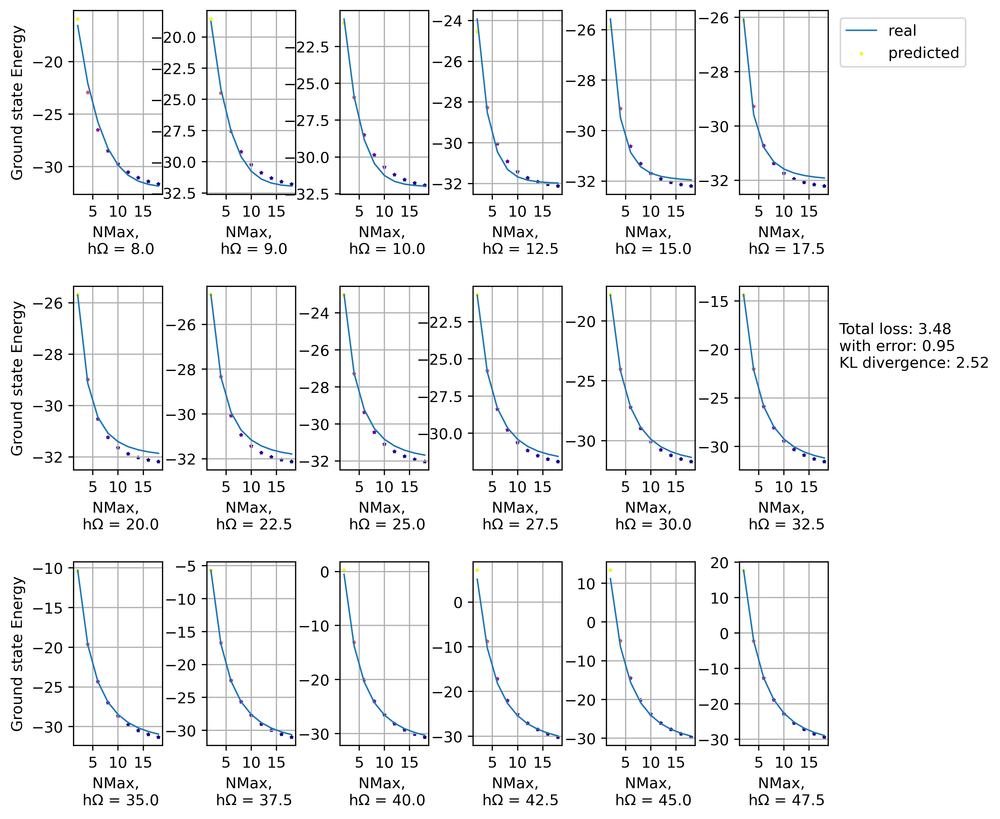

(9, 19, 2)
Step: 18000 Total_Loss:3.624008893966675 with error 0.8885291218757629 KL divergence2.7354798316955566


<Figure size 432x288 with 0 Axes>

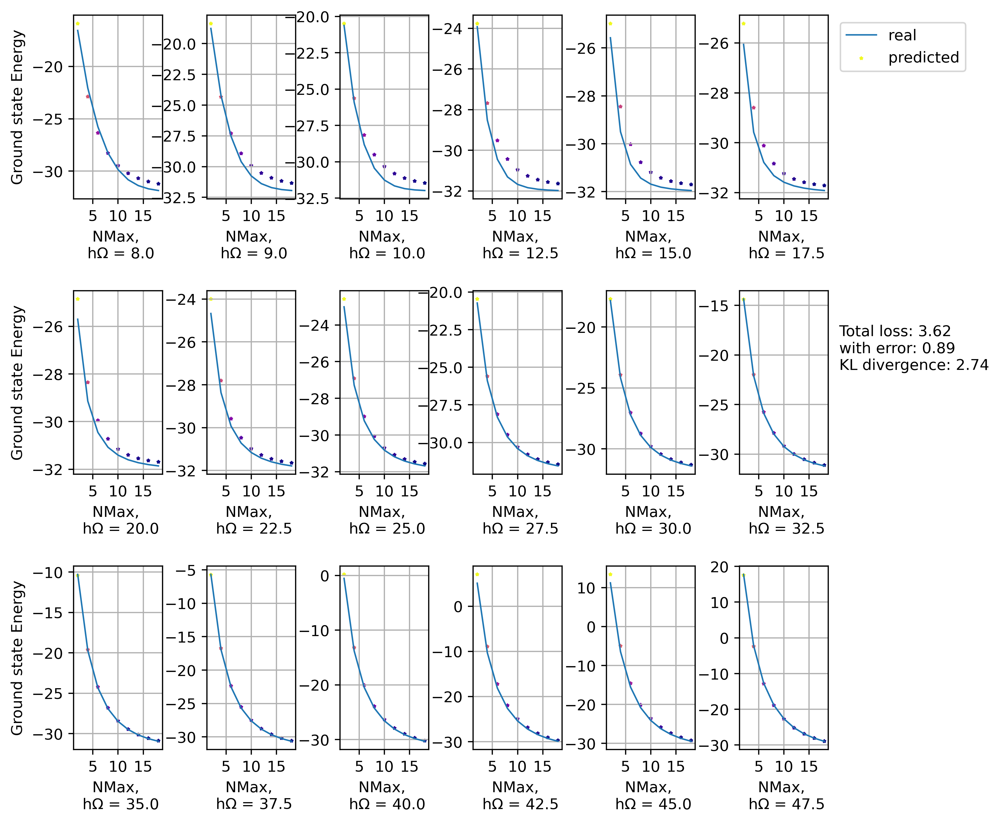

(9, 19, 2)
Step: 19000 Total_Loss:3.6929543018341064 with error 0.83583003282547 KL divergence2.857123851776123


<Figure size 432x288 with 0 Axes>

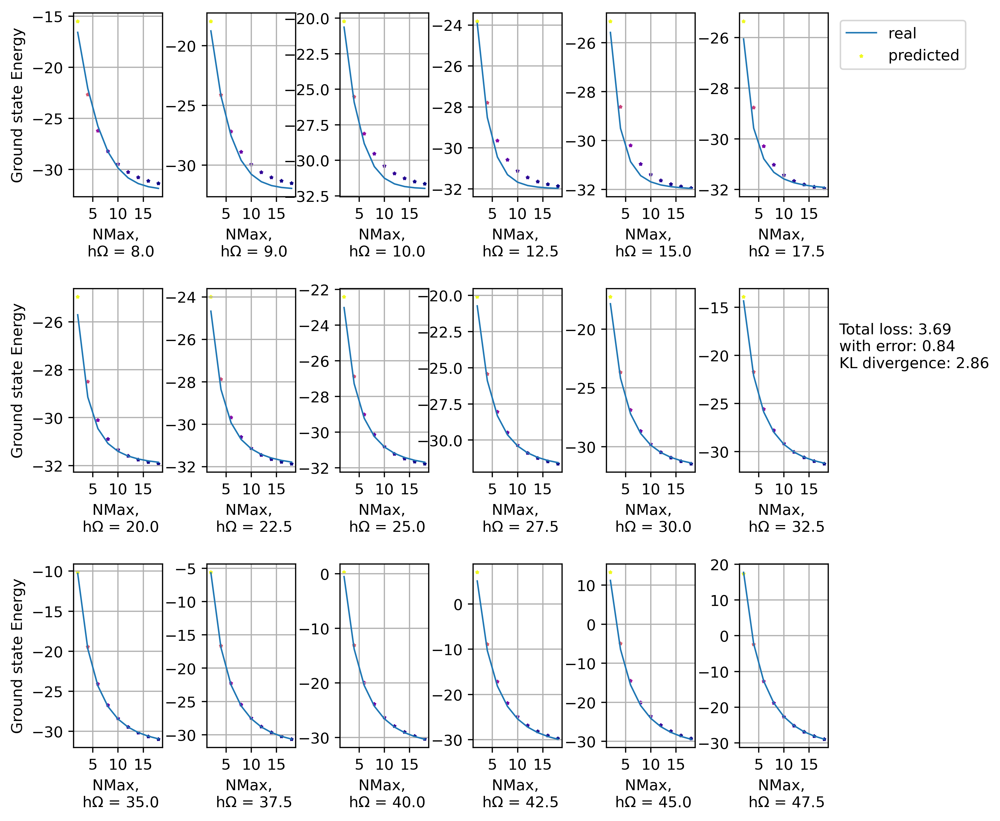

(9, 19, 2)
Step: 20000 Total_Loss:3.3391354084014893 with error 0.786450982093811 KL divergence2.5526843070983887


<Figure size 432x288 with 0 Axes>

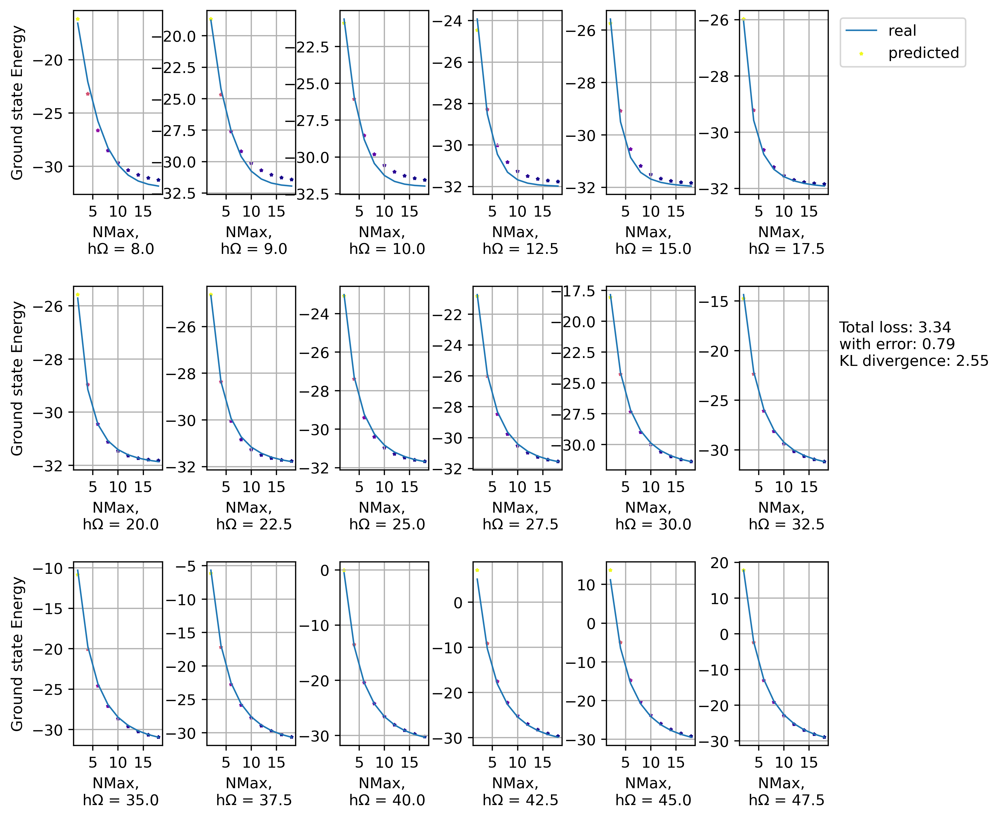

(9, 19, 2)
Step: 21000 Total_Loss:3.3868460655212402 with error 0.6805455684661865 KL divergence2.7063002586364746


<Figure size 432x288 with 0 Axes>

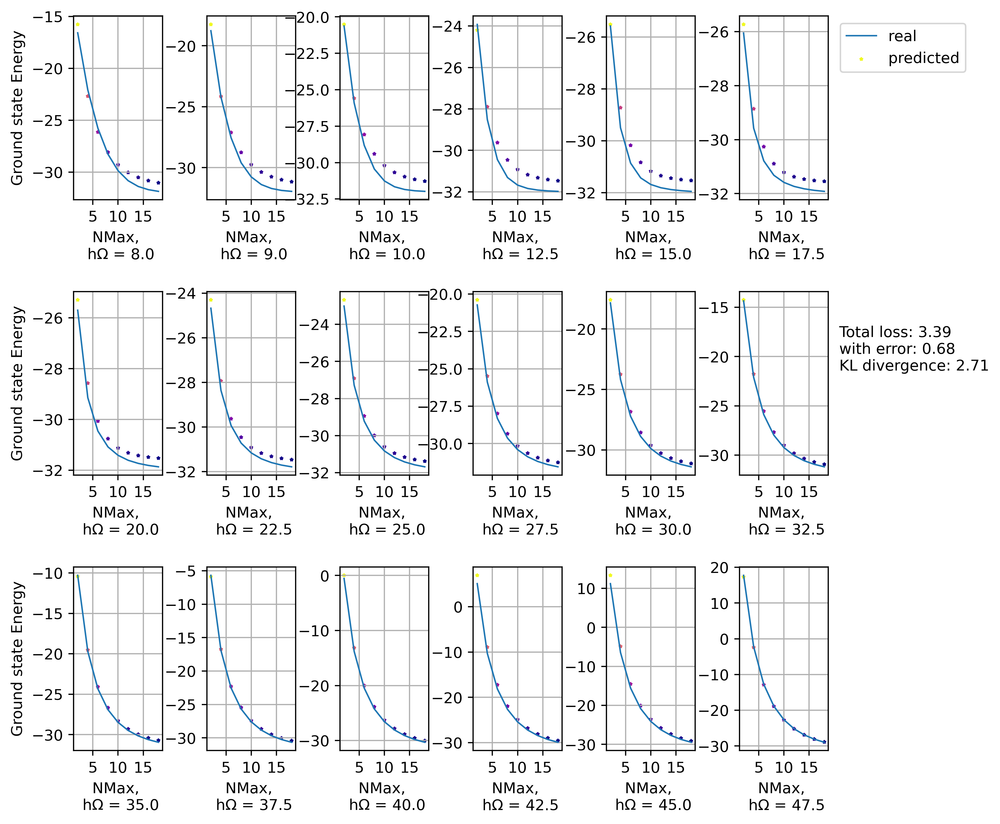

(9, 19, 2)
Step: 22000 Total_Loss:3.347407579421997 with error 1.0360000133514404 KL divergence2.3114075660705566


<Figure size 432x288 with 0 Axes>

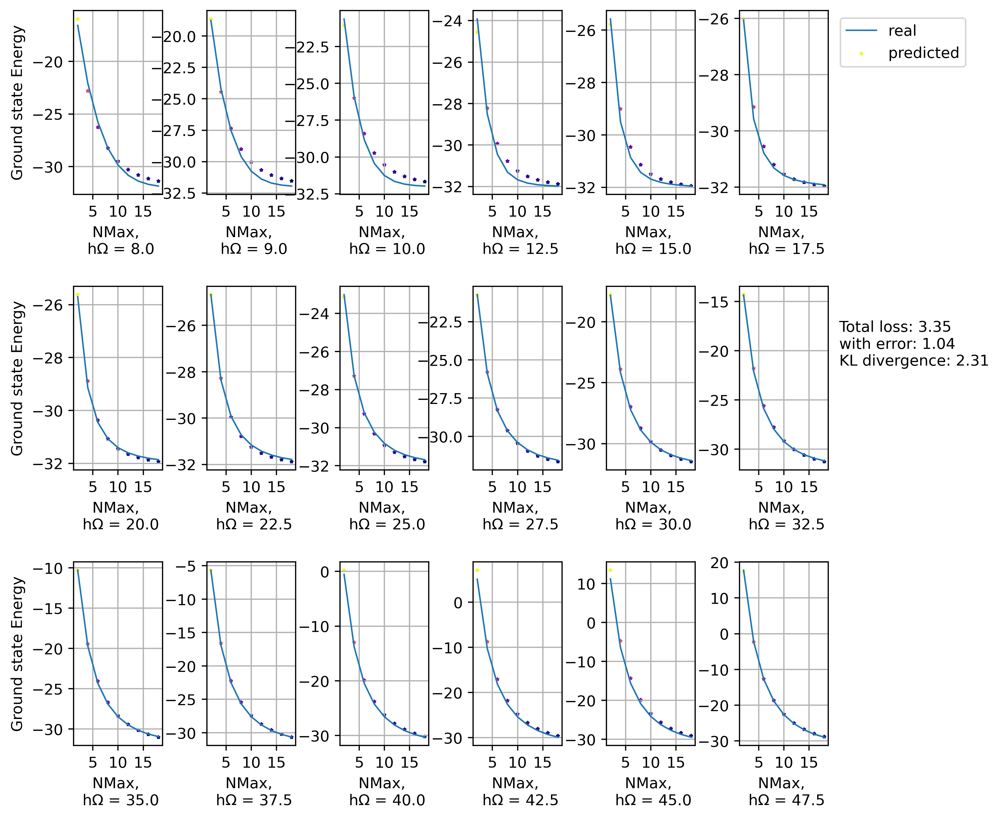

(9, 19, 2)
Step: 23000 Total_Loss:4.456092834472656 with error 1.2713344097137451 KL divergence3.184758424758911


<Figure size 432x288 with 0 Axes>

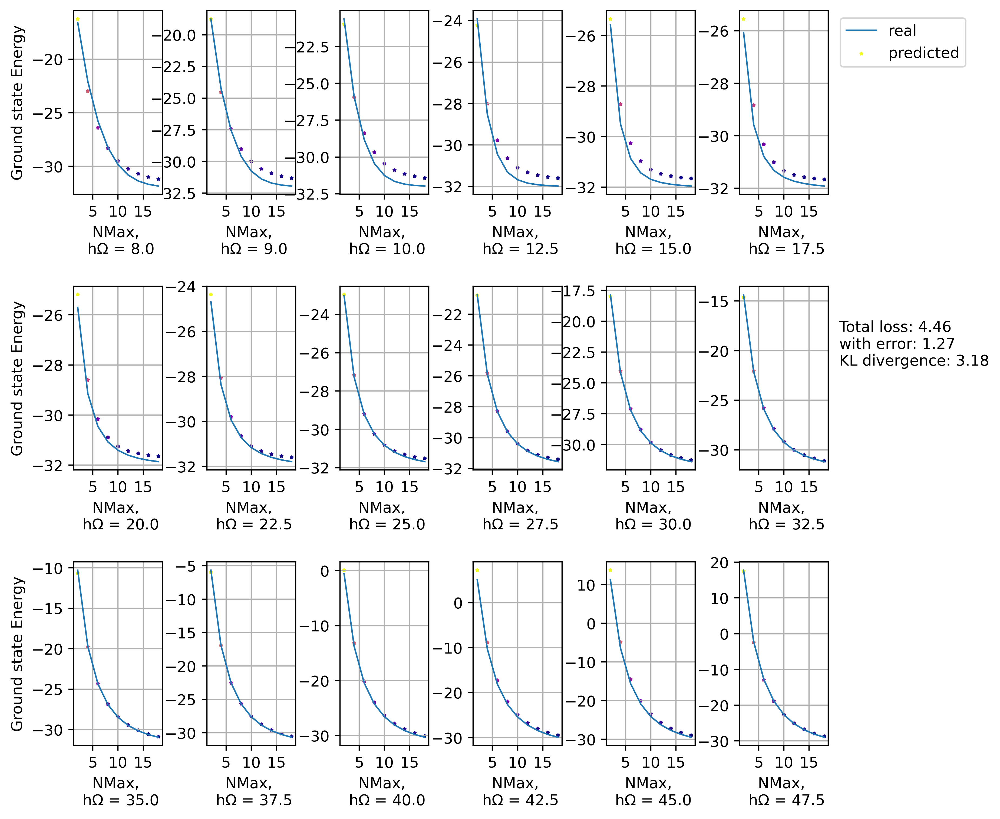

(9, 19, 2)
Step: 24000 Total_Loss:3.5560741424560547 with error 1.0972449779510498 KL divergence2.458829402923584


<Figure size 432x288 with 0 Axes>

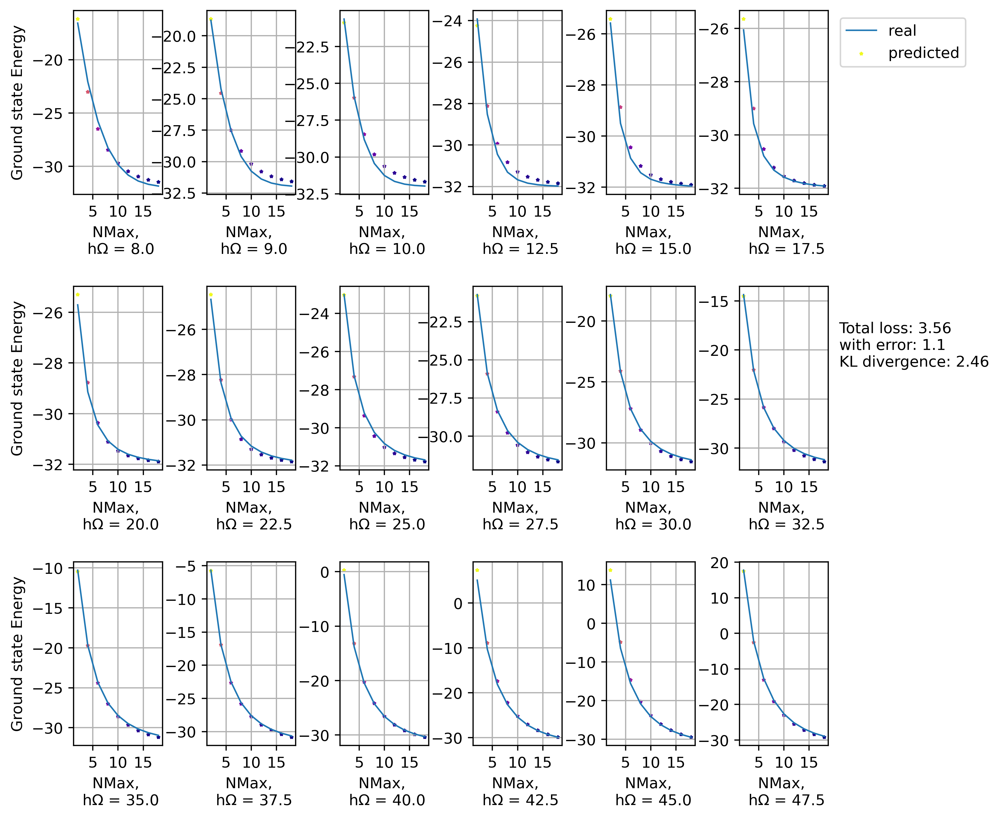

(9, 19, 2)
Step: 25000 Total_Loss:2.979517698287964 with error 0.5922725796699524 KL divergence2.3872451782226562


<Figure size 432x288 with 0 Axes>

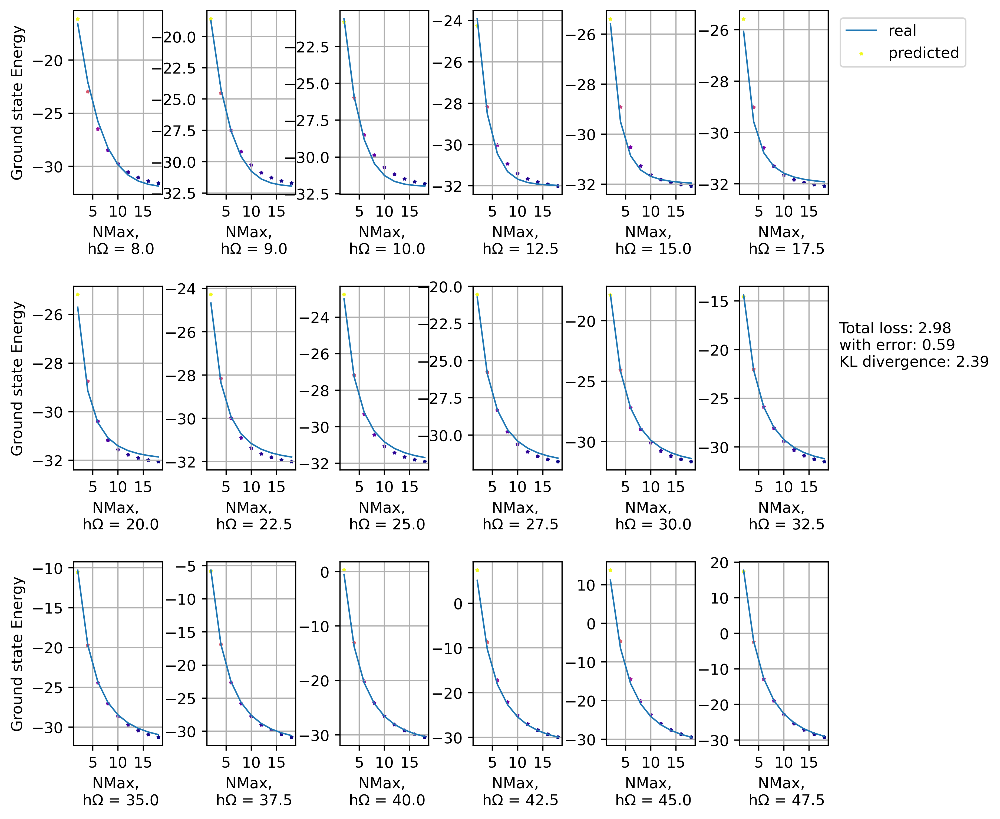

(9, 19, 2)
Step: 26000 Total_Loss:3.2870705127716064 with error 0.766067385673523 KL divergence2.521003246307373


<Figure size 432x288 with 0 Axes>

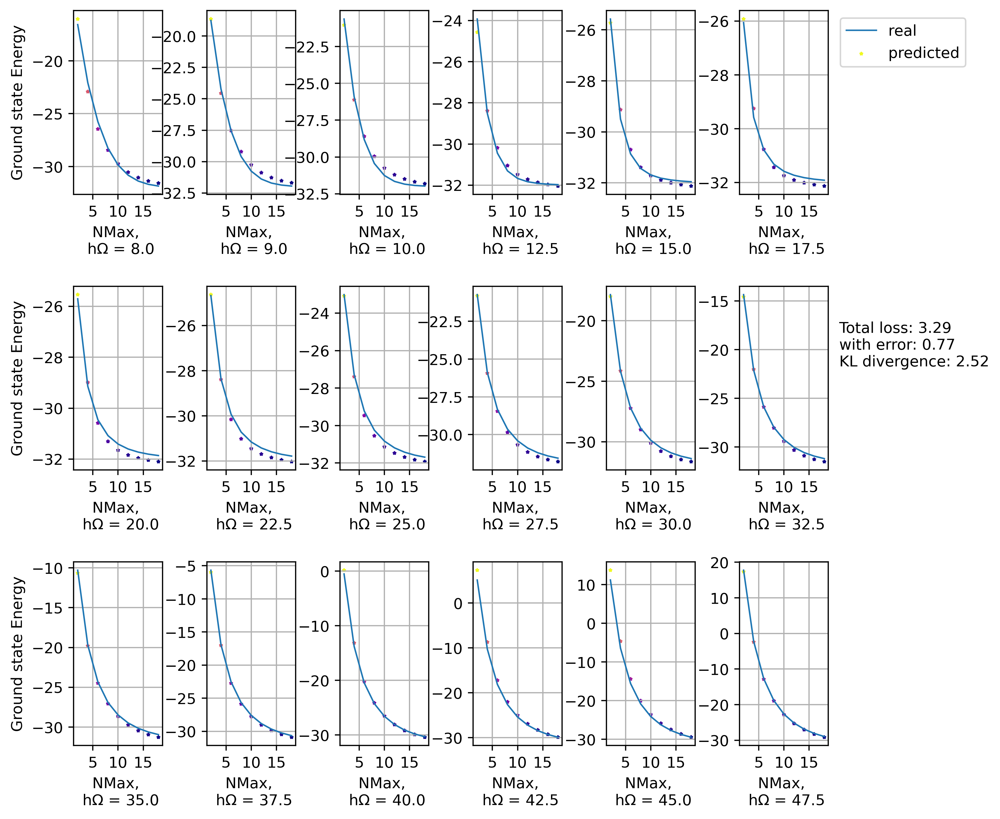

(9, 19, 2)
Step: 27000 Total_Loss:3.607909679412842 with error 0.8340746760368347 KL divergence2.773834466934204


<Figure size 432x288 with 0 Axes>

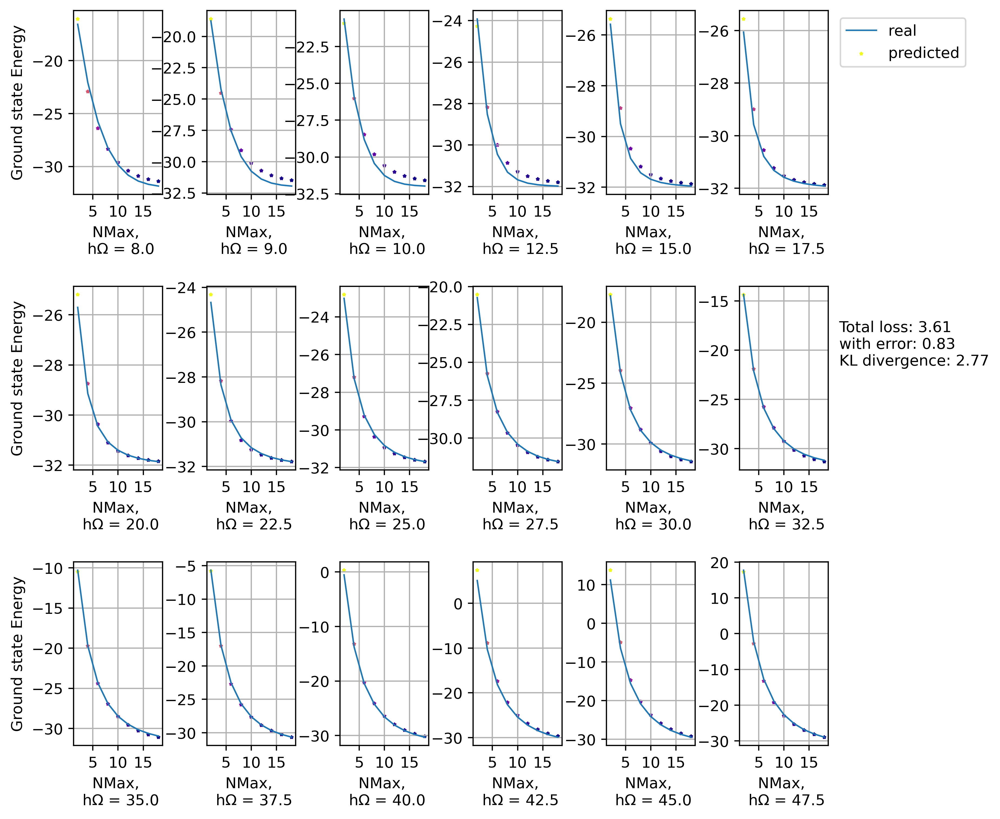

(9, 19, 2)
Step: 28000 Total_Loss:4.706235408782959 with error 0.9617535471916199 KL divergence3.7444820404052734


<Figure size 432x288 with 0 Axes>

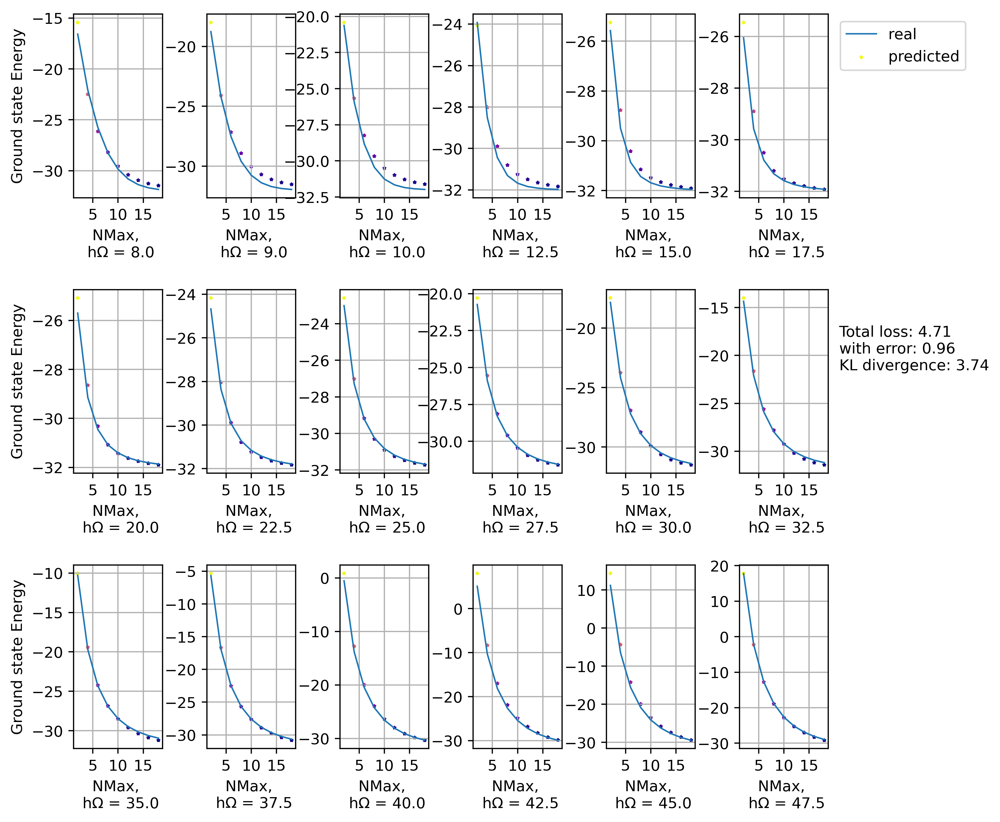

(9, 19, 2)
Step: 29000 Total_Loss:4.086483955383301 with error 0.7910101413726807 KL divergence3.295473575592041


<Figure size 432x288 with 0 Axes>

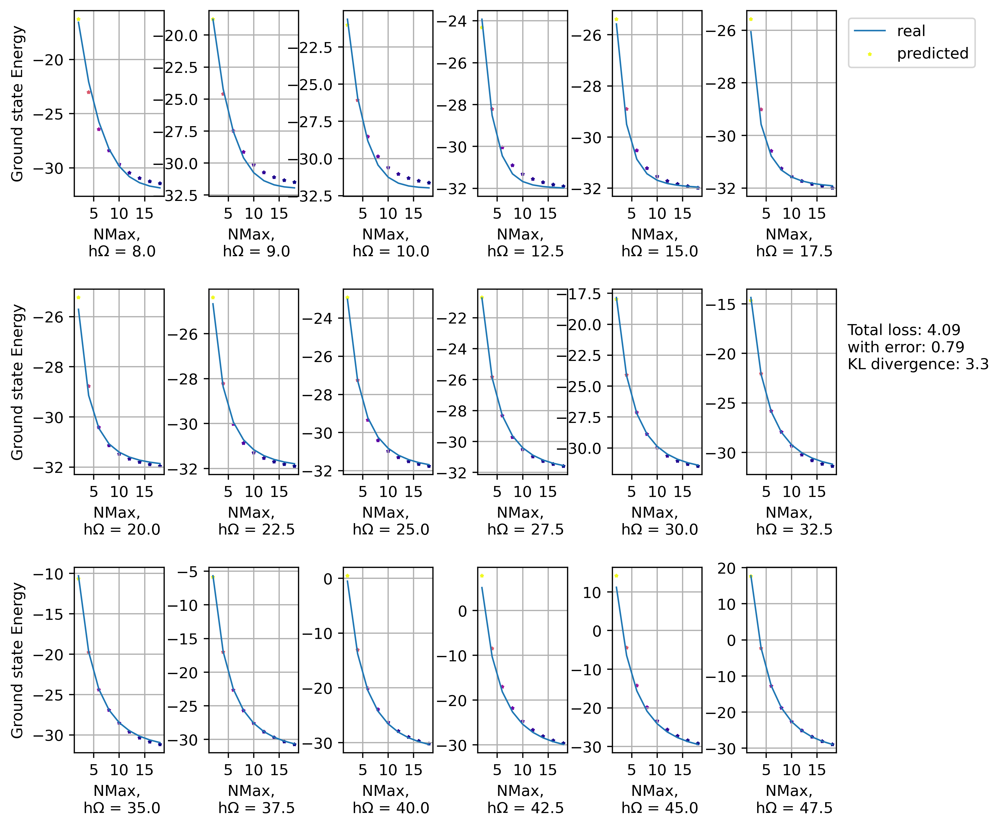

In [13]:
ode_trained = ODEVAE(2, 64, 6)
conduct_experiment_latent(X, ode_trained, 30000)


(18, 19, 1)
(18, 19, 2)


<Figure size 432x288 with 0 Axes>

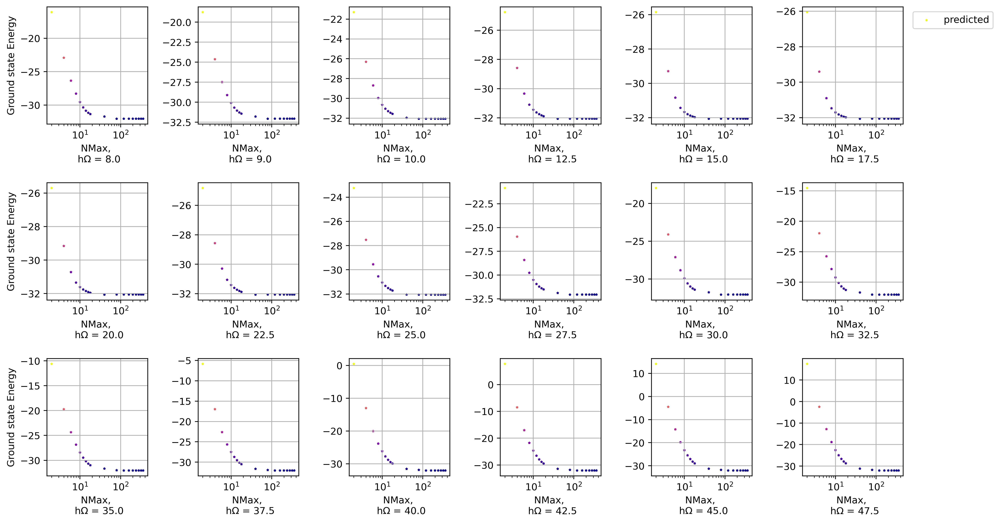

In [28]:

E = X[()]['data'][:, 1:]
h_omega = X[()]['data'][:, 0]/50
N_Max = X[()]['Nmax'].reshape([-1])/18
n_points = h_omega.shape[0]
noise_std = 1
permutation = [np.random.randint(0, n_points) for k in range(10)]
ETr = E[permutation]
h_omegaT = h_omega[permutation]

def create_batch_latent(X, y):
    idx = [ np.random.randint(0, X.shape[0]) for _ in range(20) ]

    obs_=torch.from_numpy( X[idx, :].astype(np.float32).T).unsqueeze(2)

    ts_ = np.vstack(N_Max).astype(np.float32).reshape([-1, 1])
    ts_ = torch.from_numpy(np.repeat(ts_, obs_.shape[1], axis=1)).unsqueeze(2)


    ho_ = torch.from_numpy( np.repeat( y[idx].astype(
        np.float32).reshape([1,-1]), obs_.shape[0], axis = 0)).unsqueeze(2)
    
    # print(ho_.dtype, obs_.dtype, ts_.dtype)
    # print(ho_.shape, obs_.shape, ts_.shape)

    
    return obs_, ts_, ho_


def create_batch_latent_order(X, y):
    idx = [ i for i in range(X.shape[0]) ]

    obs_=torch.from_numpy( X[idx, :].astype(np.float32).T).unsqueeze(2)

    ts_ = np.vstack(N_Max).astype(np.float32).reshape([-1, 1])
    ts_ = torch.from_numpy(np.repeat(ts_, obs_.shape[1], axis=1)).unsqueeze(2)


    ho_ = torch.from_numpy( np.repeat( y[idx].astype(
        np.float32).reshape([1,-1]), obs_.shape[0], axis = 0)).unsqueeze(2)
    
    # print(ho_.dtype, obs_.dtype, ts_.dtype)
        # print(ho_.shape, obs_.shape, ts_.shape)

    return obs_, ts_, ho_


for i in [0.5, 1, 2, 4, 6, 8, 10, 20]:
    obs_, ts_, ho_ = create_batch_latent_order(E, h_omega)
    ts_ = np.concatenate([ts_, ts_*i], axis = 0)
print(ts_.shape)
ts_ = torch.from_numpy(ts_)
obs_, _ , ho_ = create_batch_latent_order(E, h_omega)
input_d = torch.cat([obs_, ho_], axis=2)
samp_trajs_p = to_np(ode_trained.generate_with_seed(input_d, ts_))
print(samp_trajs_p.shape)

plt.figure()

fig, axes = plt.subplots(nrows=3, ncols=6, facecolor='white', figsize=(
    16, 9),  gridspec_kw={'wspace': 0.5, 'hspace': 0.5}, dpi=400)
axes = axes.flatten()
for j, ax in enumerate(axes):

    # ax.plot(18*ts_[:, j, 0], input_d[:, j, 0],
    #         label='real', linewidth=1)
    ax.scatter(18*ts_[:, j, 0], samp_trajs_p[:, j, 0], 3,
                label="predicted", marker='*',
                c=samp_trajs_p[:, j, 0], cmap=cm.plasma)
    ax.grid("True")
    ax.set_xlabel('NMax, \n h$\\Omega$ = ' +
                    str(np.round(ho_[0, j, 0].item()*50, 2)), fontsize=10)

    if j == 5:
        ax.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
    if j == 0 or j == 6 or j == 12:
        ax.set_ylabel('Ground state Energy', fontsize=10)
    ax.set_xscale('log')
plt.savefig('Figures/reconstruction_extrapolation_.png', dpi=300,  bbox_inches="tight")
plt.show()